In [1]:
%load_ext autoreload
%autoreload 2
import sys
import os

if not getattr(sys, "_src_path_added", False):
    src_path = os.path.abspath(os.path.join(os.getcwd(), ".."))
    if src_path not in sys.path:
        sys.path.insert(0, src_path)
    sys._src_path_added = True 

In [2]:
from MTGA.MTGA import *

from MTGA.MTGAInstance import Instance
import MTGA.Generators as Generators
import MTGA.Mutators as Mutators
import MTGA.WeightGenerators as WeightGenerators
import MTGA.GeneMutators as GeneMutators
import Fixers as Fixers
import Evaluators as Evaluators

from MTGA.GeneVisualizer import GeneEvolutionRenderer
from Displayer import Displayer

from Utils import *
from MTGA.MTGAUtils import *

## Main Instance

In [3]:
instance = Instance("../problems/p5.json",
    evaluator=Evaluators.CummulativeEvaluator(),
    mutator=Mutators.WalkMutator(),
    generator=Generators.TruncatedNormal(),
    fixer=Fixers.ChoiceFixer(),
    weight_generator=WeightGenerators.SoftmaxWeights(),
    gene_mutator=GeneMutators.Normal())

problem size 24
fire starts [1]
num teams 3


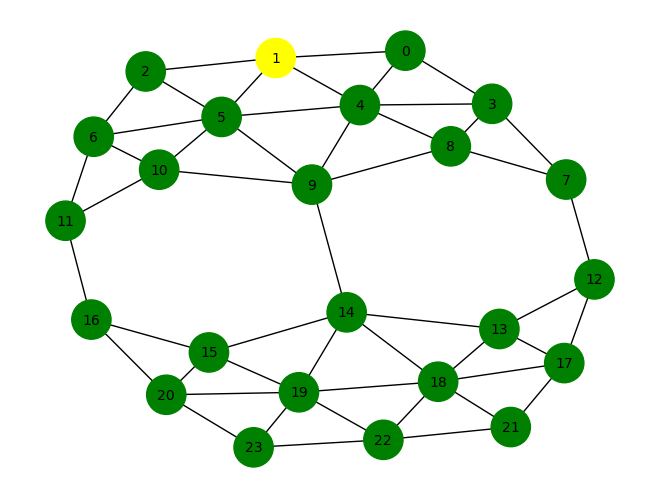

In [4]:
print("problem size", instance.size)
print("fire starts", instance.problem.fire_starts)
print("num teams", instance.problem.num_teams)
draw_graph(instance.problem)

In [5]:
displayer = Displayer()
gene_displayer = GeneEvolutionRenderer()

## The Run

In [6]:
data = optimize_and_collect(instance)

[2025-02-09 18:23:17][  0]     0.09988570     0.09967542 { 37.00000000  47.37200000  86.00000000   7.30955648}
[2025-02-09 18:23:17][  1]     0.21734333     0.11487651 { 37.00000000  47.10200000  95.00000000   7.64771835}
[2025-02-09 18:23:17][  2]     0.33368134     0.11345673 { 37.00000000  47.62400000 225.00000000  10.78492578}
[2025-02-09 18:23:17][  3]     0.44806910     0.10785699 { 37.00000000  47.81800000 270.00000000  17.91225491}
[2025-02-09 18:23:17][  4]     0.56102037     0.10970259 { 37.00000000  48.97400000 270.00000000  17.99214618}
[2025-02-09 18:23:17][  5]     0.66167951     0.09668827 { 38.00000000  47.62600000  86.00000000   7.63741606}
[2025-02-09 18:23:17][  6]     0.76020575     0.09692907 { 38.00000000  48.75800000 269.00000000  21.22468930}
[2025-02-09 18:23:17][  7]     0.87389946     0.11213779 { 37.00000000  47.89000000 292.00000000  16.39176318}
[2025-02-09 18:23:17][  8]     0.97979951     0.10299659 { 37.00000000  47.52200000  95.00000000   7.73986537}
[

In [7]:
solutions = correct_solutions(instance)

## Results

In [8]:
best_solution, best_solutions_value = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value}]:\n{best_solution}")

Best solution [12]:
[7, 9, 11]


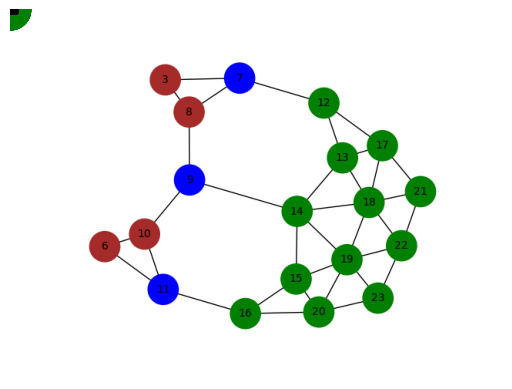

In [9]:
instance.problem.visualize_fire_without_burned(displayer, best_solution)

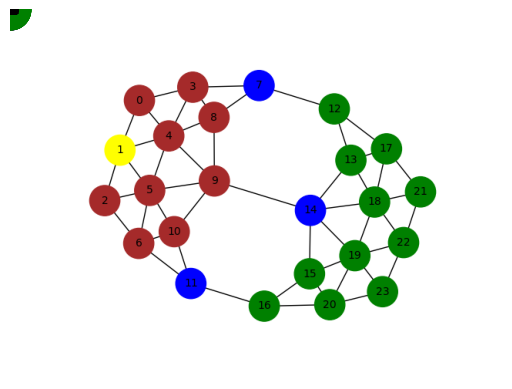

In [10]:
instance.problem.visualize_fires(displayer, solutions)

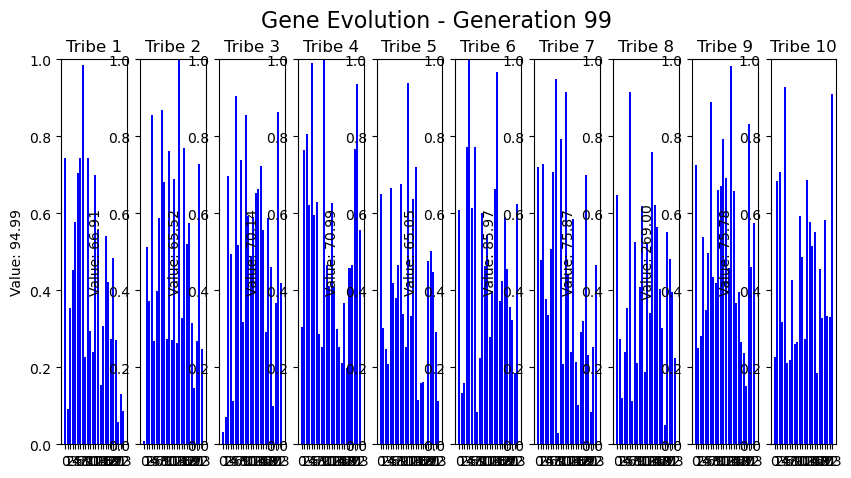

In [11]:
gene_displayer.visualize(data)

## Instance 200

data collected


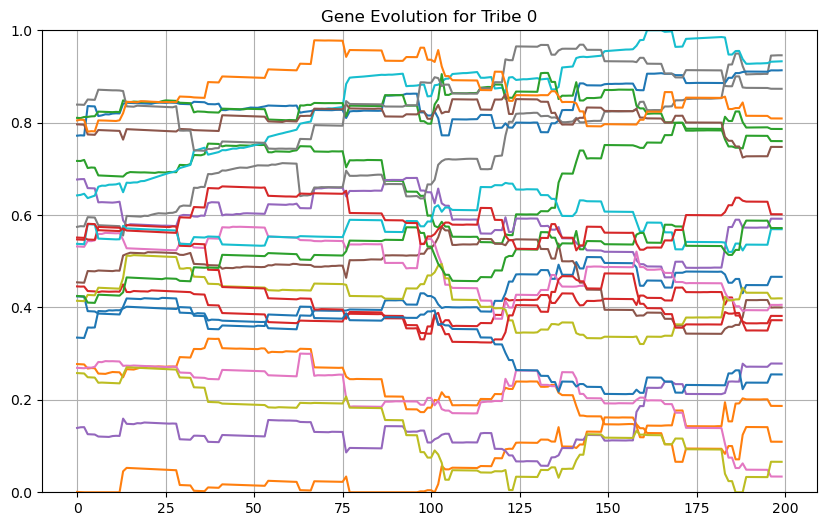

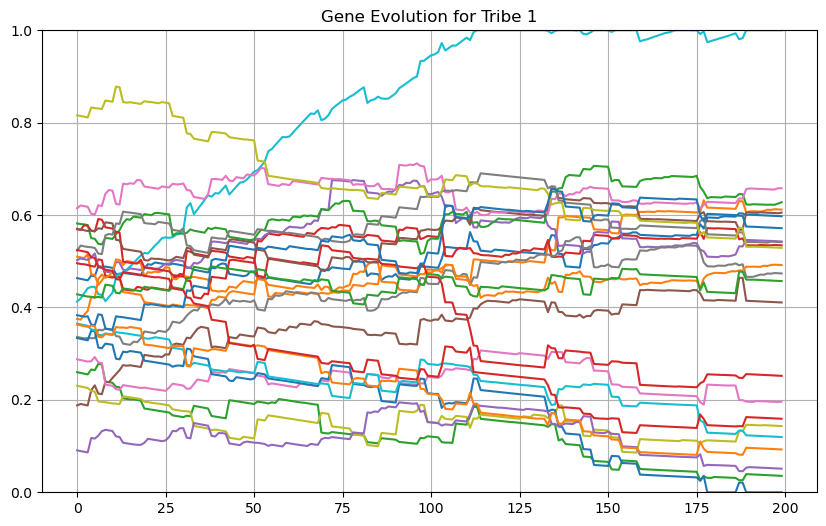

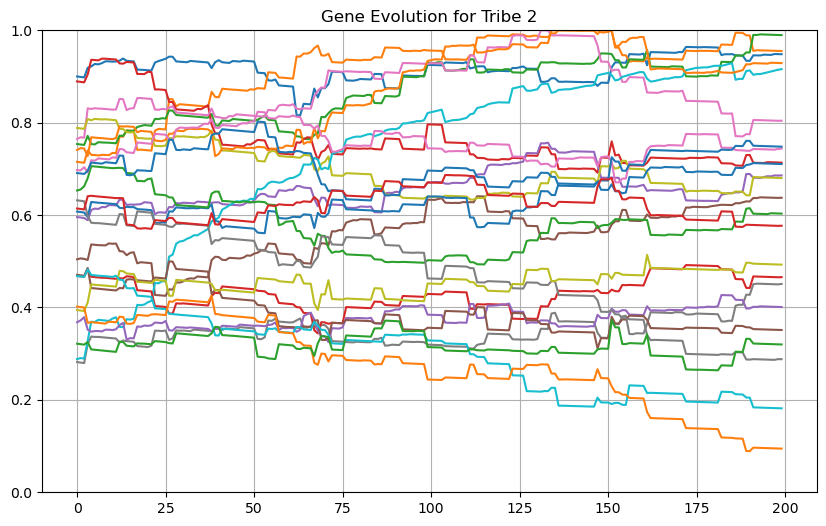

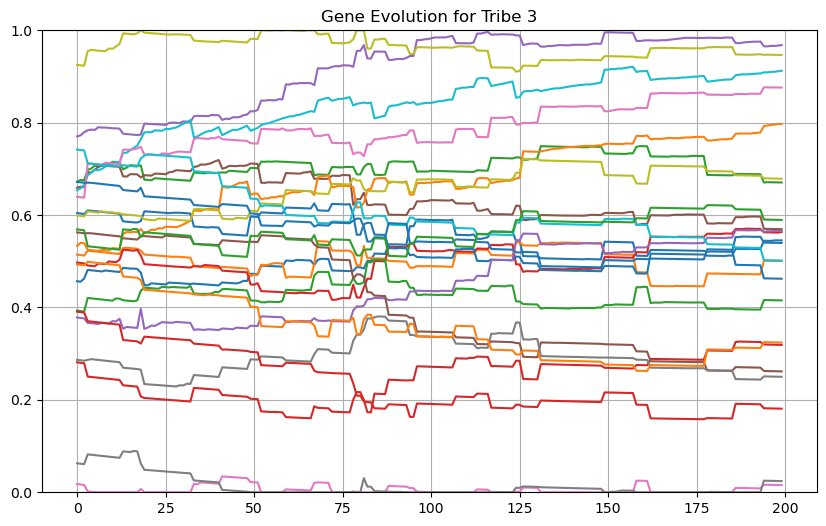

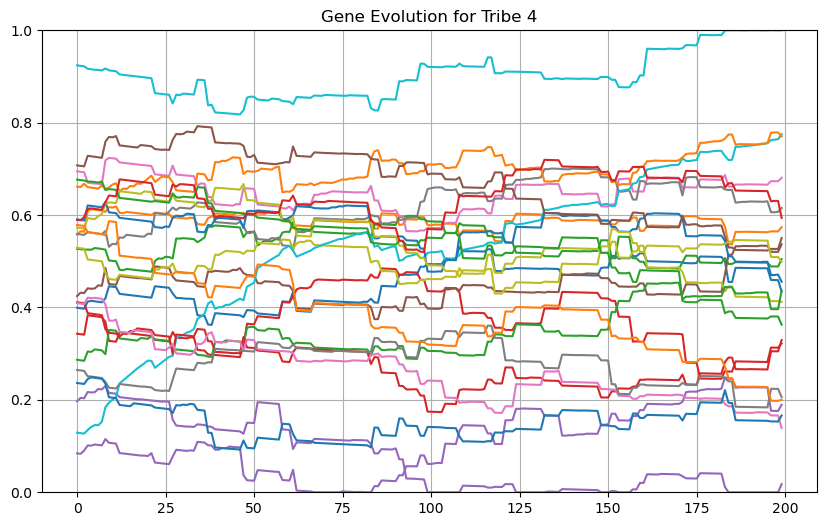

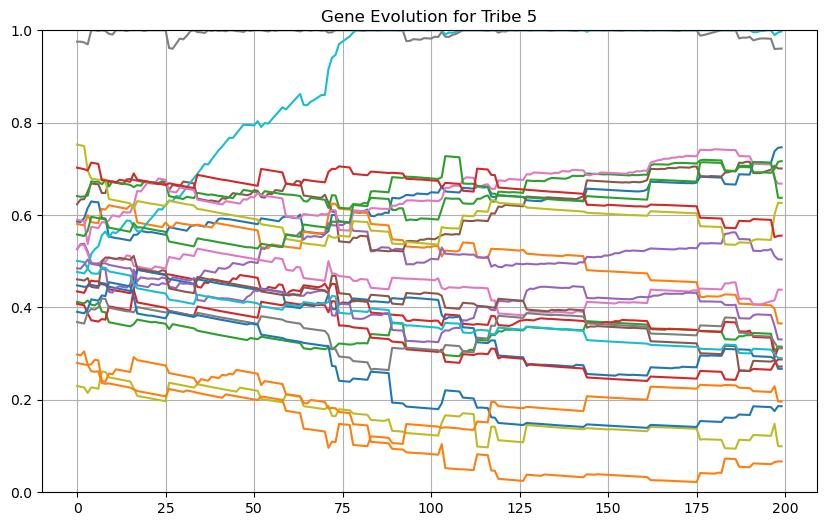

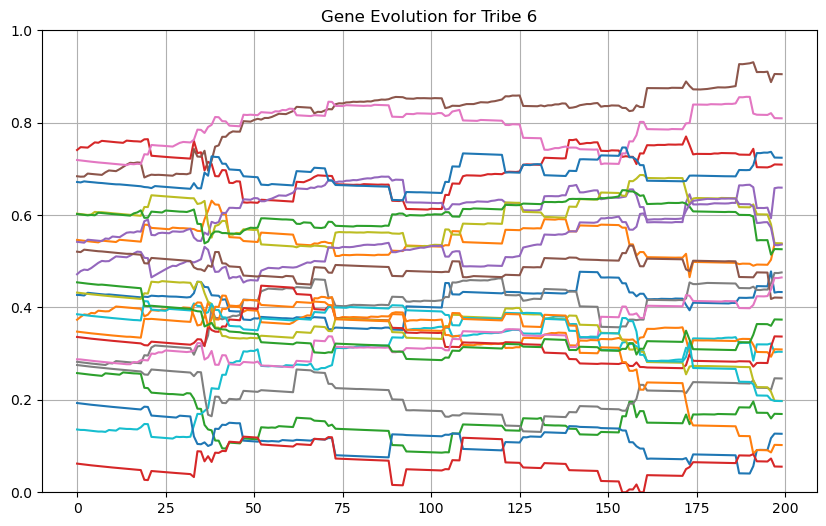

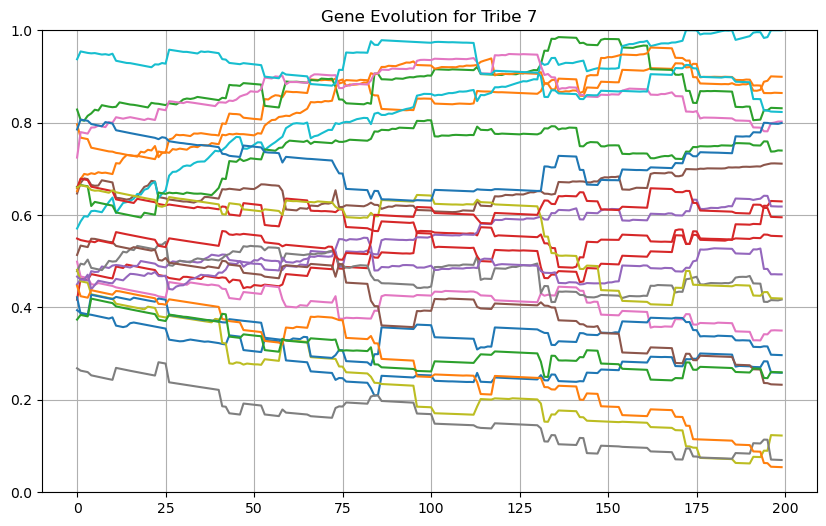

In [16]:
data200, instance200 = collect_and_visualize("../problems/p5.json", local_step_size=0.04, sigma=0.02)

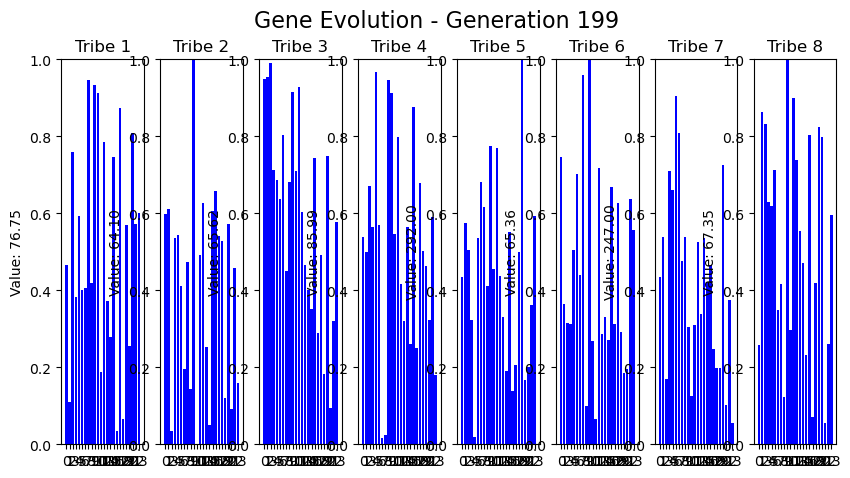

In [17]:
gene_displayer.visualize(data200)

In [18]:
solutions = correct_solutions(instance200)

In [19]:
best_solution_200, best_solutions_value_200 = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value_200}]:\n{best_solution_200}")

Best solution [12]:
[7, 9, 11]
